Importing the necessary library

In [ ]:
!pip install torch_snippets torch_summary --quiet
import itertools
from PIL import Image
from torch_snippets import *
from torchvision import transforms
from torchvision.utils import make_grid
from torchsummary import summary

[03/19/24 00:34:13] WARNING  Skipping cv2 import                                                                                                      ]8;id=770790;file:///opt/conda/lib/python3.10/site-packages/torch_snippets/loader.py:146\loader.py]8;;\:]8;id=457208;file:///opt/conda/lib/python3.10/site-packages/torch_snippets/loader.py:146#<module>:146\<module>:146]8;;\

In [ ]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'

In [ ]:
torch.cuda.is_available()

True

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image
import pandas as pd
import os

This section of code defines a custom dataset class called Monet2ImageDataset. It takes two folders as input - one containing Monet images and the other containing real images. The __init__ method initializes the class by storing the paths of the Monet and real images. The __getitem__ method retrieves a pair of images - one Monet image and one real image - based on the index provided. The collate_fn method processes a batch of images by applying transformations and converting them to tensors. The __len__ method returns the maximum length of either the Monet or real images list.


The images are resized to a slightly larger size than the desired IMAGE_SIZE, introducing a degree of distortion in aspect ratio. Following this, a random crop is applied, effectively extracting a central patch from the resized image. This random cropping technique serves as a form of data augmentation, providing variations in the training dataset and enhancing the model's ability to generalize to unseen data. Additionally, a random horizontal flip is applied further augmenting the dataset by introducing mirror images. Subsequently, the images are converted into PyTorch tensors.

In [ ]:
IMAGE_SIZE = 256
device = 'cuda' if torch.cuda.is_available() else 'cpu'
transform = transforms.Compose([
    transforms.Resize(int(IMAGE_SIZE*1.33)),
    transforms.RandomCrop((IMAGE_SIZE,IMAGE_SIZE)),
    transforms.RandomHorizontalFlip(),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
])

horse=monet
zebra=paint

In [ ]:
img = Image.open('HW_06 Dataset/testA/00090.jpg')
img.size

(256, 256)

In [ ]:
class Monet2ImageDataset(Dataset):
    def __init__(self, monet_folder, real_folder):
        self.monet_images = Glob(monet_folder)
        self.real_images = Glob(real_folder)

    def __getitem__(self, idx):
        monet_img = Image.open(self.monet_images[idx % len(self.monet_images)]).convert('RGB')
        real_img = Image.open(self.real_images[randint(len(self.real_images))]).convert('RGB')
        return monet_img, real_img

    def __len__(self):
        return max(len(self.monet_images), len(self.real_images))

    def collate_fn(self, batch):
        monet_images, real_images = zip(*batch)
        monet_tensors = torch.stack([transform(img) for img in monet_images])
        real_tensors = torch.stack([transform(img) for img in real_images])
        return monet_tensors.to(device), real_tensors.to(device)

In [ ]:
trn_ds = Monet2ImageDataset('HW_06 Dataset/trainA', 'HW_06 Dataset/trainB')
val_ds = Monet2ImageDataset('HW_06 Dataset/testA', 'HW_06 Dataset/testB')

trn_dl = DataLoader(trn_ds, batch_size=1, shuffle=True, collate_fn=trn_ds.collate_fn)
val_dl = DataLoader(val_ds, batch_size=5, shuffle=True, collate_fn=val_ds.collate_fn)

The model consists of two main components: the generators (G_AB and G_BA) and the discriminators (D_A and D_B)

Generator (GeneratorResNet):
The generator consists of a series of residual blocks followed by downsampling and upsampling layers. It takes an image as input and aims to transform it into an image that appears to belong to monet. The architecture employs residual blocks, which facilitate the training of deep networks by enabling the gradient flow through the skip connections. The generator aims to minimize three main losses: adversarial loss (to fool the discriminators), cycle consistency loss (to ensure that translating from one domain to another and back results in the original image), and identity loss (to preserve the identity of the input image).

Discriminator (Discriminator):
The discriminator is responsible for distinguishing between real images and fake images generated by the corresponding generator.
It consists of several convolutional layers followed by downsampling, which enables the discriminator to effectively capture and discriminate features of real and fake images. The discriminator aims to minimize the adversarial loss by correctly classifying real and fake images.

Training Process:
The training process involves alternating optimization steps between the generators and the discriminators. In each iteration, real images are fed into their respective generators to produce fake images. These fake images are then used to compute the adversarial loss for each discriminator. The generators are updated to minimize the adversarial loss, cycle consistency loss, and identity loss, while the discriminators are updated to better distinguish between real and fake images. The training process is guided by several hyperparameters, such as the learning rates for the generators and discriminators, the weights assigned to different loss terms (e.g., lambda_cyc and lambda_id), and the choice of loss functions (e.g., Mean Squared Error Loss for adversarial loss and L1 Loss for cycle consistency and identity losses). The training loop iterates over the dataset for a number of epochs, updating the generators and discriminators using the defined optimization algorithms and loss functions.

In [ ]:
def weights_init_normal(m):
    classname = m.__class__.__name__
    if classname.find("Conv") != -1:
        torch.nn.init.normal_(m.weight.data, 0.0, 0.02)
        if hasattr(m, "bias") and m.bias is not None:
            torch.nn.init.constant_(m.bias.data, 0.0)
    elif classname.find("BatchNorm2d") != -1:
        torch.nn.init.normal_(m.weight.data, 1.0, 0.02)
        torch.nn.init.constant_(m.bias.data, 0.0)

In [ ]:
class ResidualBlock(nn.Module):
    def __init__(self, in_features):
        super(ResidualBlock, self).__init__()

        self.block = nn.Sequential(
            nn.ReflectionPad2d(1),
            nn.Conv2d(in_features, in_features, 3),
            nn.InstanceNorm2d(in_features),
            nn.ReLU(inplace=True),
            nn.ReflectionPad2d(1),
            nn.Conv2d(in_features, in_features, 3),
            nn.InstanceNorm2d(in_features),
        )

    def forward(self, x):
        return x + self.block(x)

In [ ]:
class GeneratorResNet(nn.Module):
    def __init__(self, num_residual_blocks=9):
        super(GeneratorResNet, self).__init__()
        out_features = 64
        channels = 3
        model = [
            nn.ReflectionPad2d(3),
            nn.Conv2d(channels, out_features, 7),
            nn.InstanceNorm2d(out_features),
            nn.ReLU(inplace=True),
        ]
        in_features = out_features
        # Downsampling
        for _ in range(2):
            out_features *= 2
            model += [
                nn.Conv2d(in_features, out_features, 3, stride=2, padding=1),
                nn.InstanceNorm2d(out_features),
                nn.ReLU(inplace=True),
            ]
            in_features = out_features

        # Residual blocks
        for _ in range(num_residual_blocks):
            model += [ResidualBlock(out_features)]

        # Upsampling
        for _ in range(2):
            out_features //= 2
            model += [
                nn.Upsample(scale_factor=2),
                nn.Conv2d(in_features, out_features, 3, stride=1, padding=1),
                nn.InstanceNorm2d(out_features),
                nn.ReLU(inplace=True),
            ]
            in_features = out_features

        # Output layer
        model += [nn.ReflectionPad2d(channels), nn.Conv2d(out_features, channels, 7), nn.Tanh()]
        self.model = nn.Sequential(*model)
        self.apply(weights_init_normal)
    def forward(self, x):
        return self.model(x)

In [ ]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()

        channels, height, width = 3, IMAGE_SIZE, IMAGE_SIZE

        def discriminator_block(in_filters, out_filters, normalize=True):
            """Returns downsampling layers of each discriminator block"""
            layers = [nn.Conv2d(in_filters, out_filters, 4, stride=2, padding=1)]
            if normalize:
                layers.append(nn.InstanceNorm2d(out_filters))
            layers.append(nn.LeakyReLU(0.2, inplace=True))
            return layers

        self.model = nn.Sequential(
            *discriminator_block(channels, 64, normalize=False),
            *discriminator_block(64, 128),
            *discriminator_block(128, 256),
            *discriminator_block(256, 512),
            nn.ZeroPad2d((1, 0, 1, 0)),
            nn.Conv2d(512, 1, 4, padding=1)
        )
        self.apply(weights_init_normal)

    def forward(self, img):
        return self.model(img)

In [ ]:
@torch.no_grad()
def generate_sample():
    data = next(iter(val_dl))
    G_AB.eval()
    G_BA.eval()

    real_A, real_B = data
    fake_B = G_AB(real_A)
    fake_A = G_BA(real_B)
    # Arange images along x-axis
    real_A = make_grid(real_A, nrow=5, normalize=True)
    real_B = make_grid(real_B, nrow=5, normalize=True)
    fake_A = make_grid(fake_A, nrow=5, normalize=True)
    fake_B = make_grid(fake_B, nrow=5, normalize=True)
    # Arange images along y-axis
    image_grid = torch.cat((real_A, fake_B, real_B, fake_A), 1)
    show(image_grid.detach().cpu().permute(1,2,0).numpy(), sz=12)

In [ ]:
def generator_train_step(Gs, optimizer, real_A, real_B):
    G_AB, G_BA = Gs
    optimizer.zero_grad()
    loss_id_A = criterion_identity(G_BA(real_A), real_A)
    loss_id_B = criterion_identity(G_AB(real_B), real_B)

    loss_identity = (loss_id_A + loss_id_B) / 2
    fake_B = G_AB(real_A)
    loss_GAN_AB = criterion_GAN(D_B(fake_B), torch.Tensor(np.ones((len(real_A), 1, 16, 16))).to(device))
    fake_A = G_BA(real_B)
    loss_GAN_BA = criterion_GAN(D_A(fake_A), torch.Tensor(np.ones((len(real_A), 1, 16, 16))).to(device))

    loss_GAN = (loss_GAN_AB + loss_GAN_BA) / 2
    recov_A = G_BA(fake_B)
    loss_cycle_A = criterion_cycle(recov_A, real_A)
    recov_B = G_AB(fake_A)
    loss_cycle_B = criterion_cycle(recov_B, real_B)

    loss_cycle = (loss_cycle_A + loss_cycle_B) / 2
    loss_G = loss_GAN + lambda_cyc * loss_cycle + lambda_id * loss_identity
    loss_G.backward()
    optimizer.step()
    return loss_G, loss_identity, loss_GAN, loss_cycle, loss_G, fake_A, fake_B

In [ ]:
def discriminator_train_step(D, real_data, fake_data, optimizer):
    optimizer.zero_grad()
    loss_real = criterion_GAN(D(real_data), torch.Tensor(np.ones((len(real_data), 1, 16, 16))).to(device))
    loss_fake = criterion_GAN(D(fake_data.detach()), torch.Tensor(np.zeros((len(real_data), 1, 16, 16))).to(device))
    loss_D = (loss_real + loss_fake) / 2
    loss_D.backward()
    optimizer.step()
    return loss_D

In [ ]:
G_AB = GeneratorResNet().to(device)
G_BA = GeneratorResNet().to(device)
D_A = Discriminator().to(device)
D_B = Discriminator().to(device)

criterion_GAN = torch.nn.MSELoss()
criterion_cycle = torch.nn.L1Loss()
criterion_identity = torch.nn.L1Loss()

optimizer_G = torch.optim.Adam(
    itertools.chain(G_AB.parameters(), G_BA.parameters()), lr=0.0002, betas=(0.5, 0.999)
)
optimizer_D_A = torch.optim.Adam(D_A.parameters(), lr=0.0002, betas=(0.5, 0.999))
optimizer_D_B = torch.optim.Adam(D_B.parameters(), lr=0.0002, betas=(0.5, 0.999))

lambda_cyc, lambda_id = 10.0, 5.0

EPOCH: 1.000  loss_D: 0.160  loss_G: 3.321  loss_GAN: 0.294  loss_cycle: 0.210  loss_identity: 0.186  (996.04s - 18924.81s remaining)

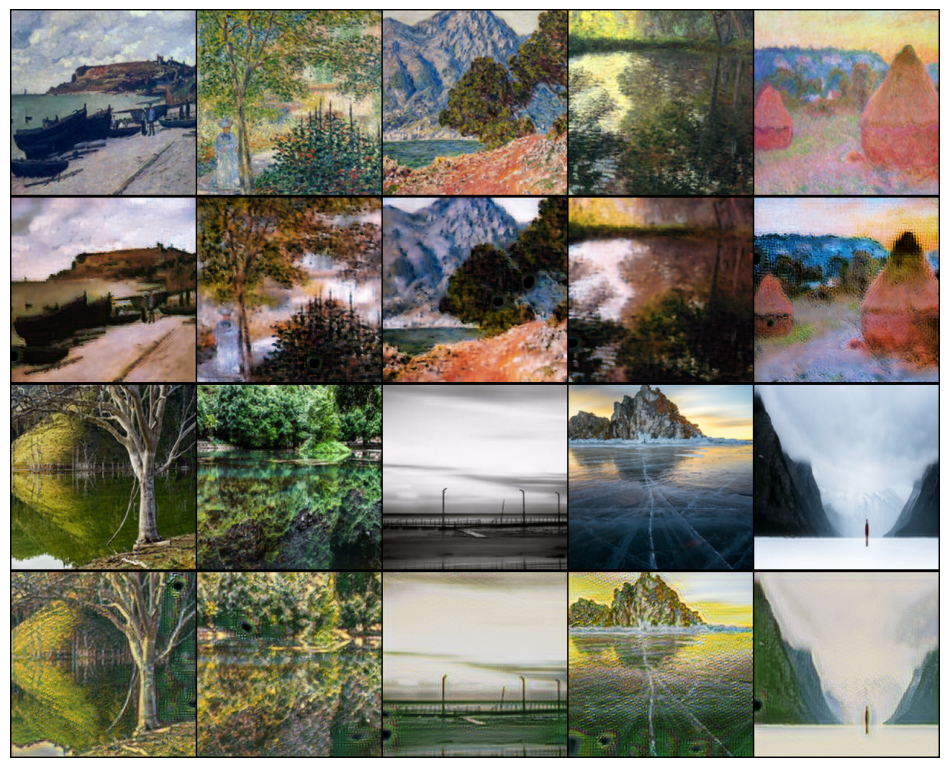

EPOCH: 1.000  loss_GAN: 0.557  loss_cycle: 0.208  loss_identity: 0.191  loss_D: 0.186  loss_G: 3.595  (996.55s - 18934.37s remaining)
EPOCH: 2.000  loss_D: 0.197  loss_G: 2.656  loss_GAN: 0.691  loss_cycle: 0.133  loss_identity: 0.128  (1990.66s - 17915.98s remaining)

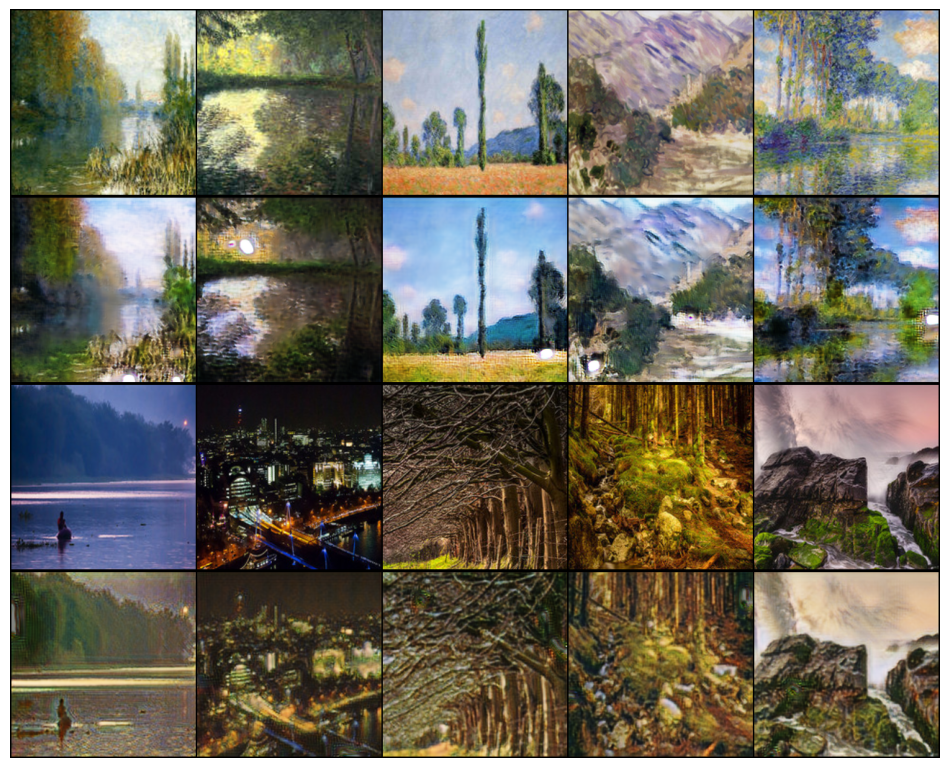

EPOCH: 2.000  loss_GAN: 0.540  loss_cycle: 0.190  loss_identity: 0.174  loss_D: 0.186  loss_G: 3.313  (1991.19s - 17920.71s remaining)
EPOCH: 3.000  loss_D: 0.094  loss_G: 2.377  loss_GAN: 0.481  loss_cycle: 0.129  loss_identity: 0.121  (2984.32s - 16911.14s remaining)

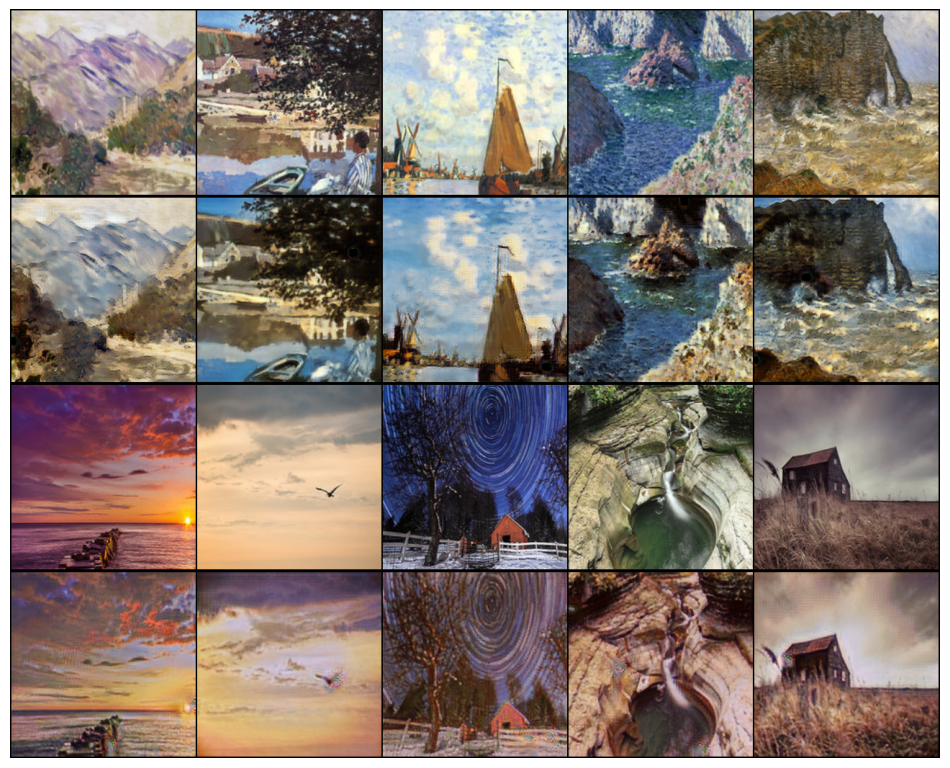

EPOCH: 3.000  loss_GAN: 0.566  loss_cycle: 0.180  loss_identity: 0.166  loss_D: 0.173  loss_G: 3.195  (2984.87s - 16914.26s remaining)
EPOCH: 4.000  loss_D: 0.094  loss_G: 3.253  loss_GAN: 0.527  loss_cycle: 0.192  loss_identity: 0.162  (3977.85s - 15911.40s remaining)

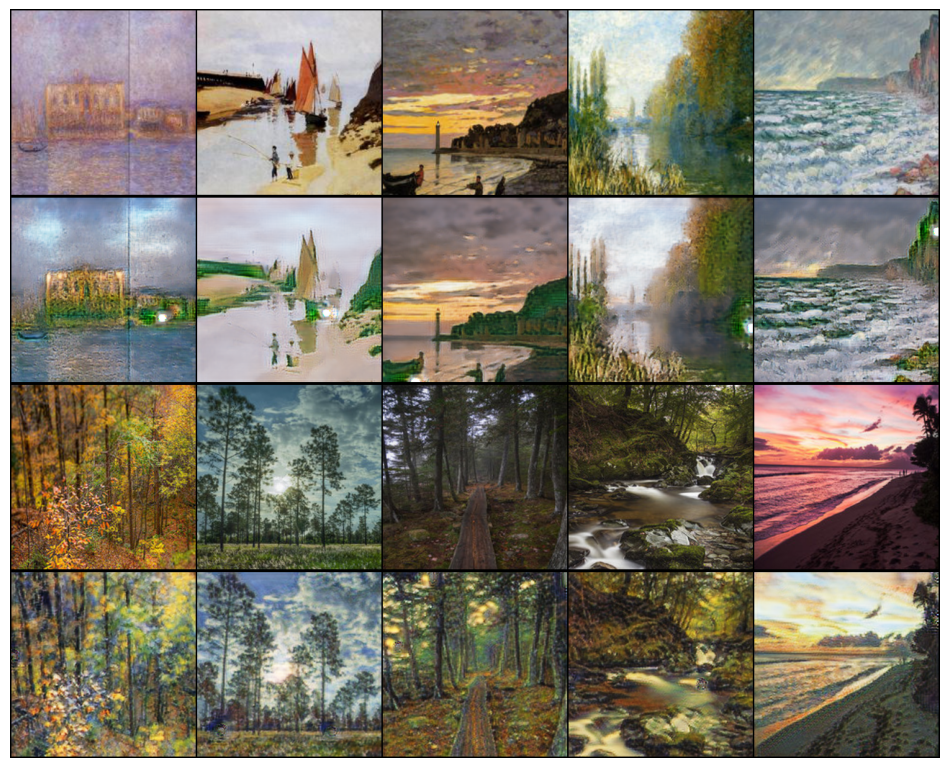

EPOCH: 4.000  loss_GAN: 0.585  loss_cycle: 0.174  loss_identity: 0.162  loss_D: 0.165  loss_G: 3.135  (3978.39s - 15913.56s remaining)
EPOCH: 5.000  loss_D: 0.140  loss_G: 3.096  loss_GAN: 0.556  loss_cycle: 0.175  loss_identity: 0.158  (4972.32s - 14916.95s remaining)

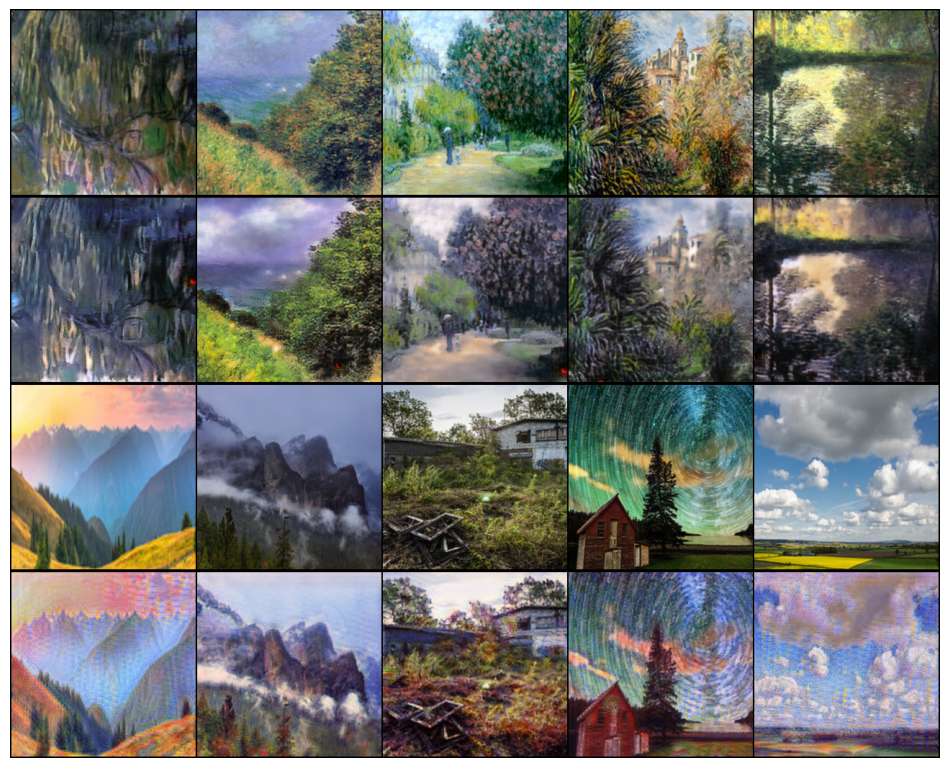

EPOCH: 5.000  loss_GAN: 0.531  loss_cycle: 0.169  loss_identity: 0.156  loss_D: 0.183  loss_G: 3.007  (4972.86s - 14918.59s remaining)
EPOCH: 6.000  loss_D: 0.131  loss_G: 2.787  loss_GAN: 0.488  loss_cycle: 0.161  loss_identity: 0.138  (5966.20s - 13921.13s remaining)

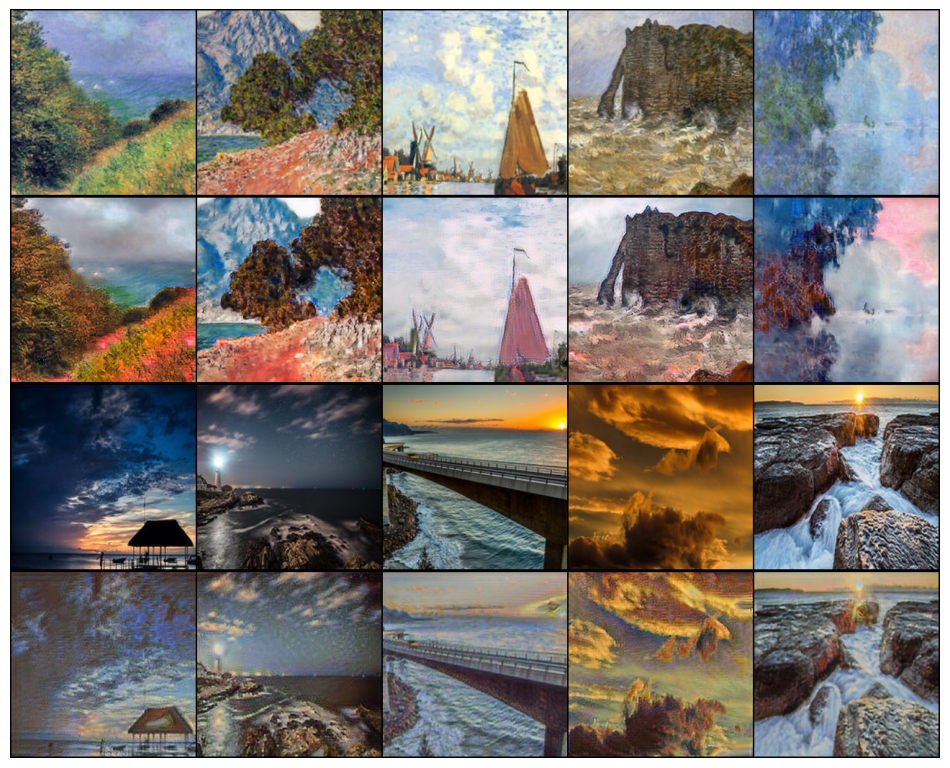

EPOCH: 6.000  loss_GAN: 0.528  loss_cycle: 0.164  loss_identity: 0.152  loss_D: 0.182  loss_G: 2.934  (5966.76s - 13922.43s remaining)
EPOCH: 7.000  loss_D: 0.320  loss_G: 3.209  loss_GAN: 0.590  loss_cycle: 0.188  loss_identity: 0.149  (6959.88s - 12925.49s remaining)

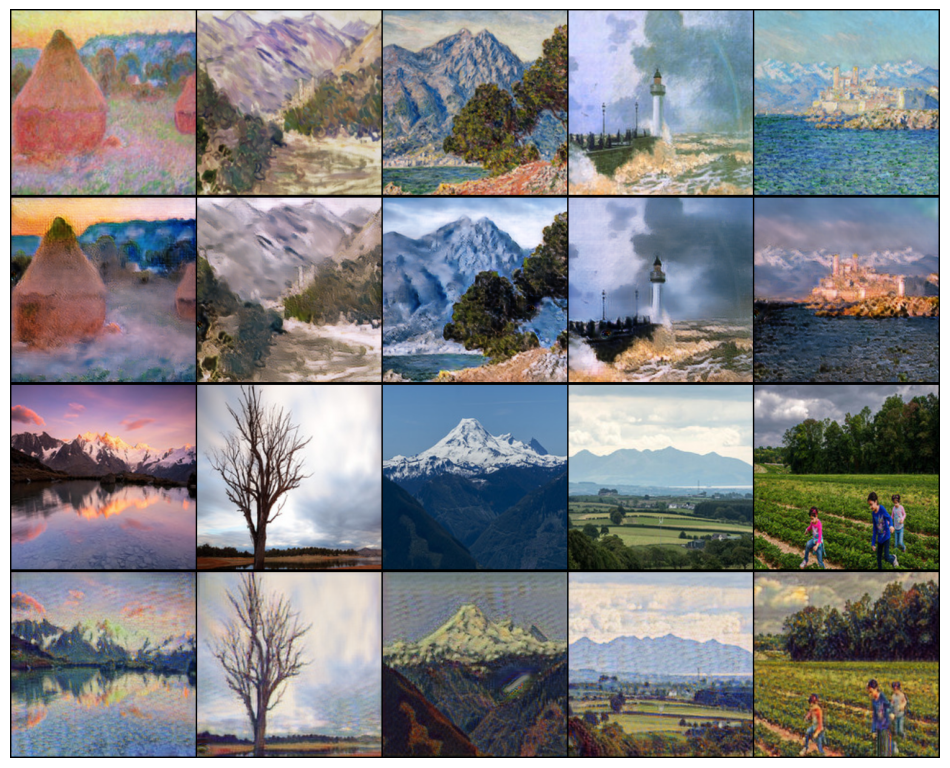

EPOCH: 7.000  loss_GAN: 0.531  loss_cycle: 0.159  loss_identity: 0.148  loss_D: 0.179  loss_G: 2.864  (6960.45s - 12926.56s remaining)
EPOCH: 8.000  loss_D: 0.131  loss_G: 2.205  loss_GAN: 0.594  loss_cycle: 0.108  loss_identity: 0.106  (7953.47s - 11930.20s remaining)

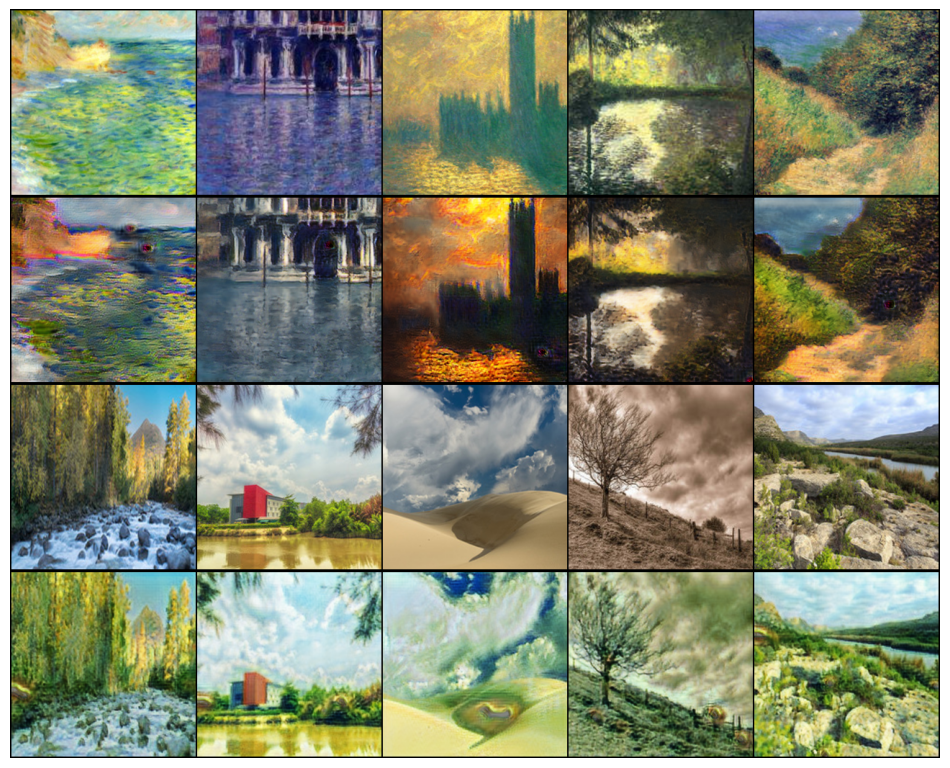

EPOCH: 8.000  loss_GAN: 0.534  loss_cycle: 0.155  loss_identity: 0.145  loss_D: 0.177  loss_G: 2.809  (7954.04s - 11931.06s remaining)
EPOCH: 9.000  loss_D: 0.062  loss_G: 2.420  loss_GAN: 0.576  loss_cycle: 0.131  loss_identity: 0.107  (8947.39s - 10935.69s remaining)

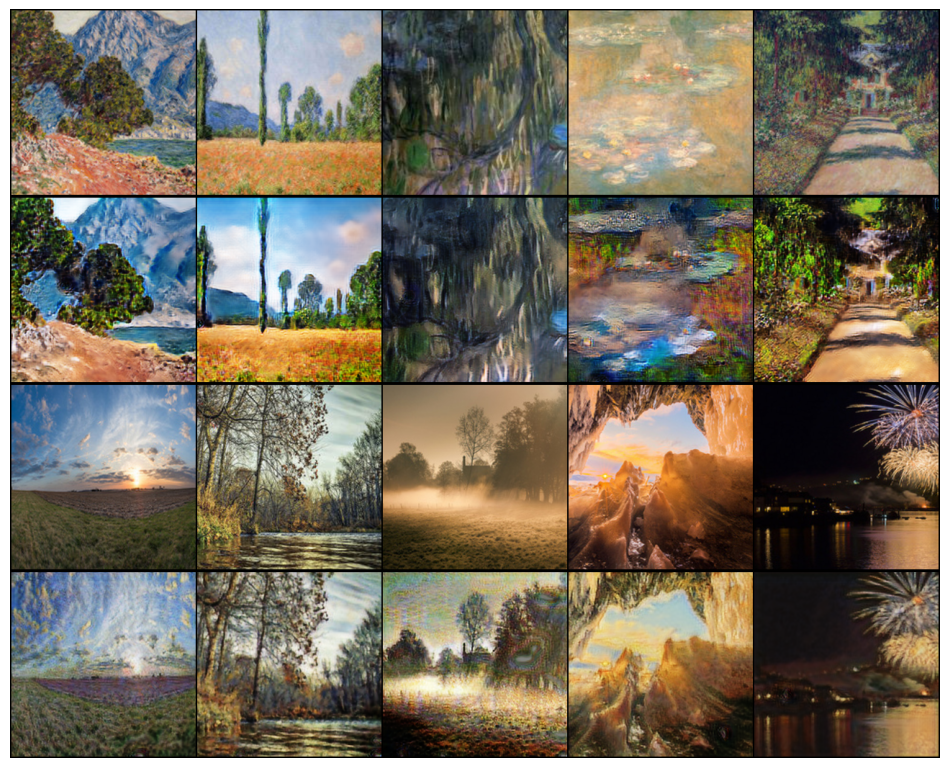

EPOCH: 9.000  loss_GAN: 0.557  loss_cycle: 0.153  loss_identity: 0.143  loss_D: 0.169  loss_G: 2.800  (8947.96s - 10936.40s remaining)
EPOCH: 10.000  loss_D: 0.127  loss_G: 2.617  loss_GAN: 0.645  loss_cycle: 0.154  loss_identity: 0.087  (9940.93s - 9940.93s remaining)

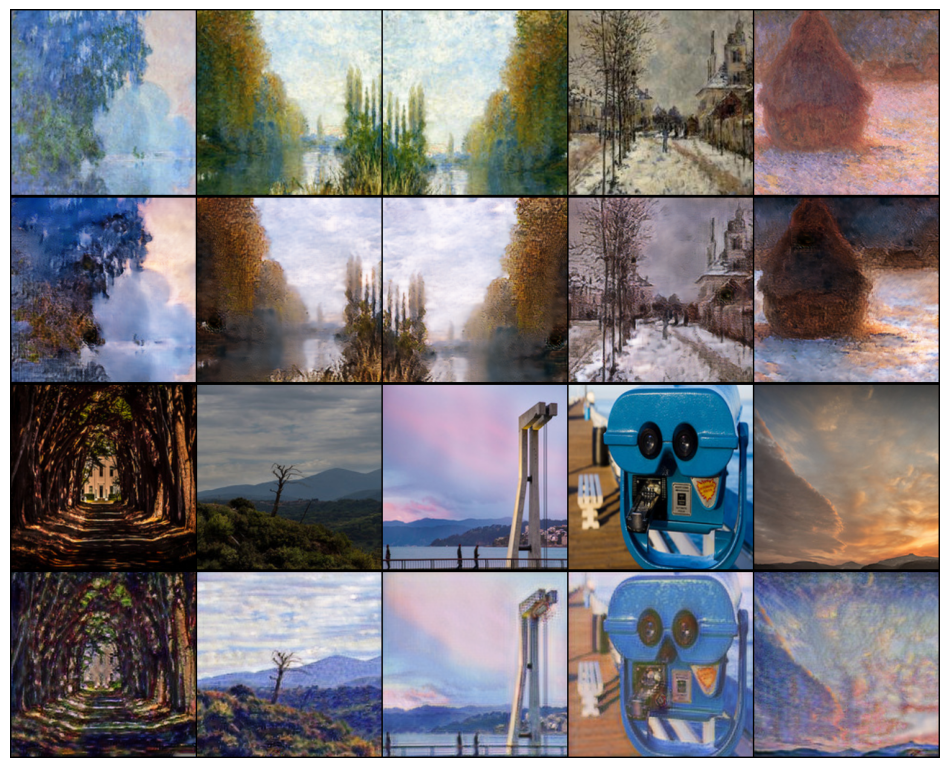

EPOCH: 10.000  loss_GAN: 0.577  loss_cycle: 0.153  loss_identity: 0.143  loss_D: 0.161  loss_G: 2.822  (9941.53s - 9941.53s remaining)
EPOCH: 11.000  loss_D: 0.137  loss_G: 2.147  loss_GAN: 0.390  loss_cycle: 0.127  loss_identity: 0.097  (10935.08s - 8946.88s remaining)

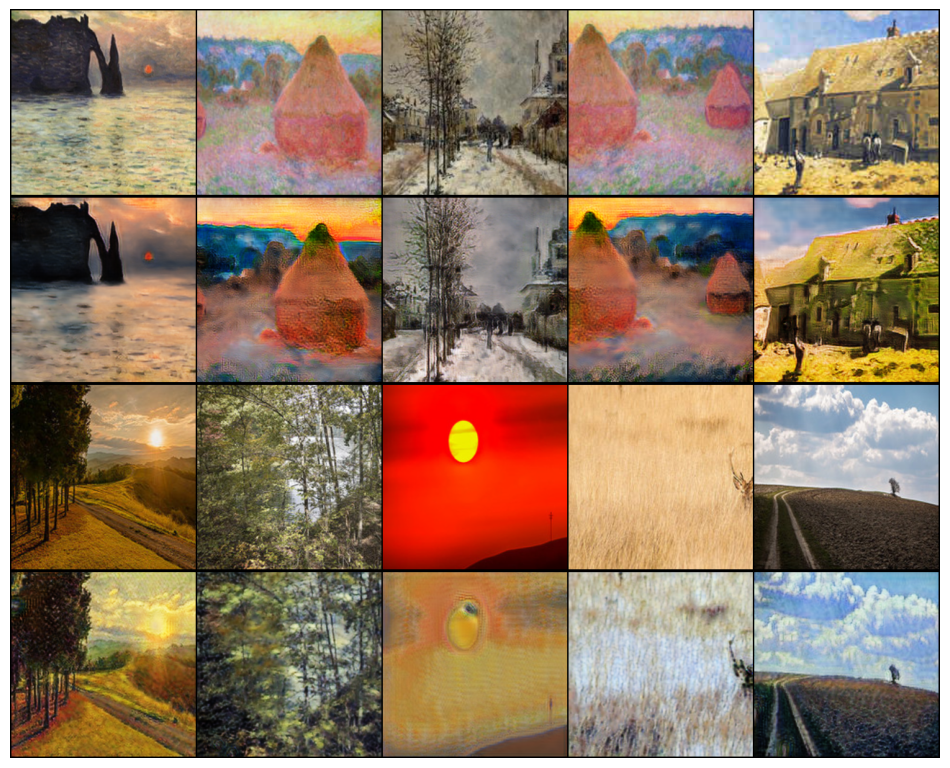

EPOCH: 11.000  loss_GAN: 0.583  loss_cycle: 0.149  loss_identity: 0.140  loss_D: 0.159  loss_G: 2.769  (10935.68s - 8947.37s remaining)
EPOCH: 12.000  loss_D: 0.089  loss_G: 2.457  loss_GAN: 0.757  loss_cycle: 0.116  loss_identity: 0.109  (11934.63s - 7956.42s remaining)

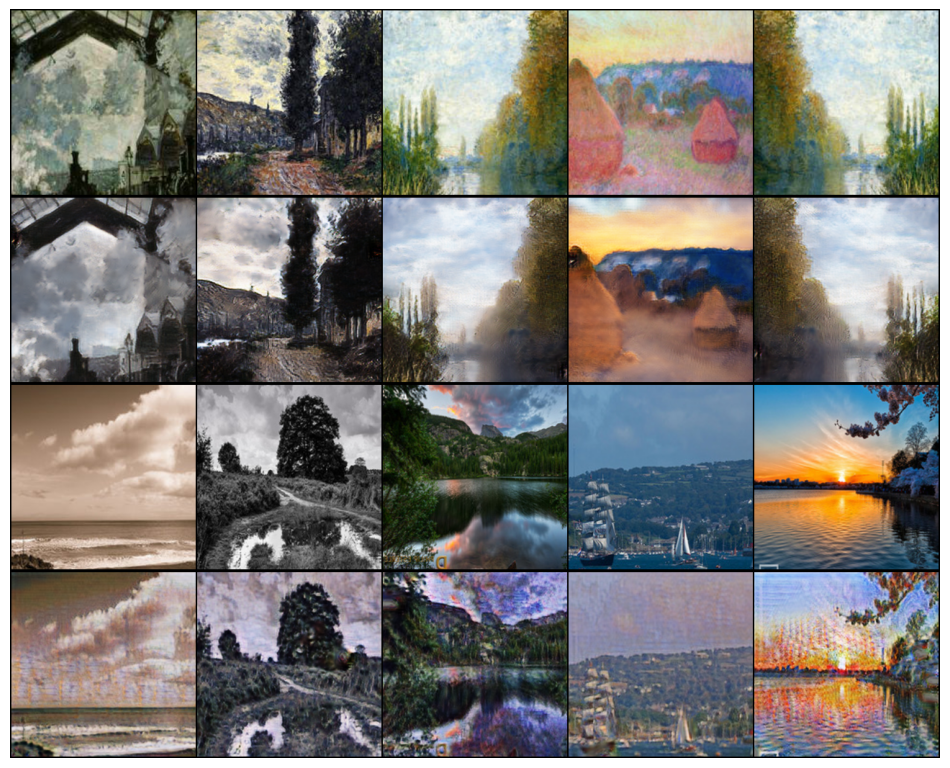

EPOCH: 12.000  loss_GAN: 0.611  loss_cycle: 0.147  loss_identity: 0.138  loss_D: 0.149  loss_G: 2.765  (11935.25s - 7956.83s remaining)
EPOCH: 13.000  loss_D: 0.050  loss_G: 2.298  loss_GAN: 0.787  loss_cycle: 0.102  loss_identity: 0.098  (12930.12s - 6962.37s remaining)

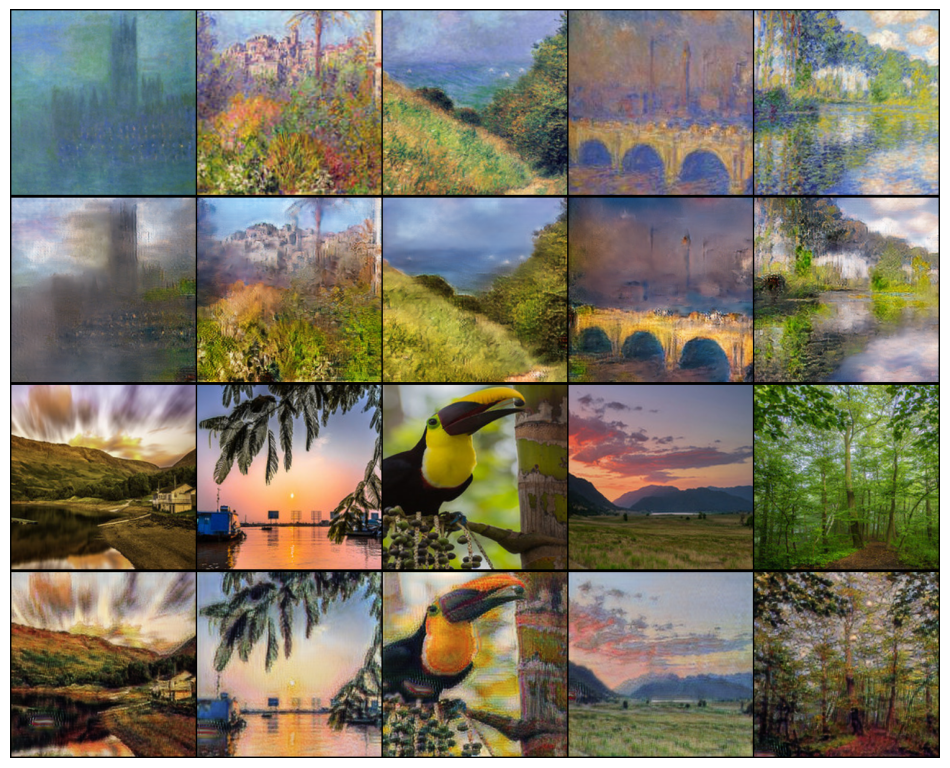

EPOCH: 13.000  loss_GAN: 0.635  loss_cycle: 0.146  loss_identity: 0.138  loss_D: 0.142  loss_G: 2.787  (12930.77s - 6962.72s remaining)
EPOCH: 14.000  loss_D: 0.064  loss_G: 3.153  loss_GAN: 0.795  loss_cycle: 0.171  loss_identity: 0.130  (13924.01s - 5967.43s remaining)

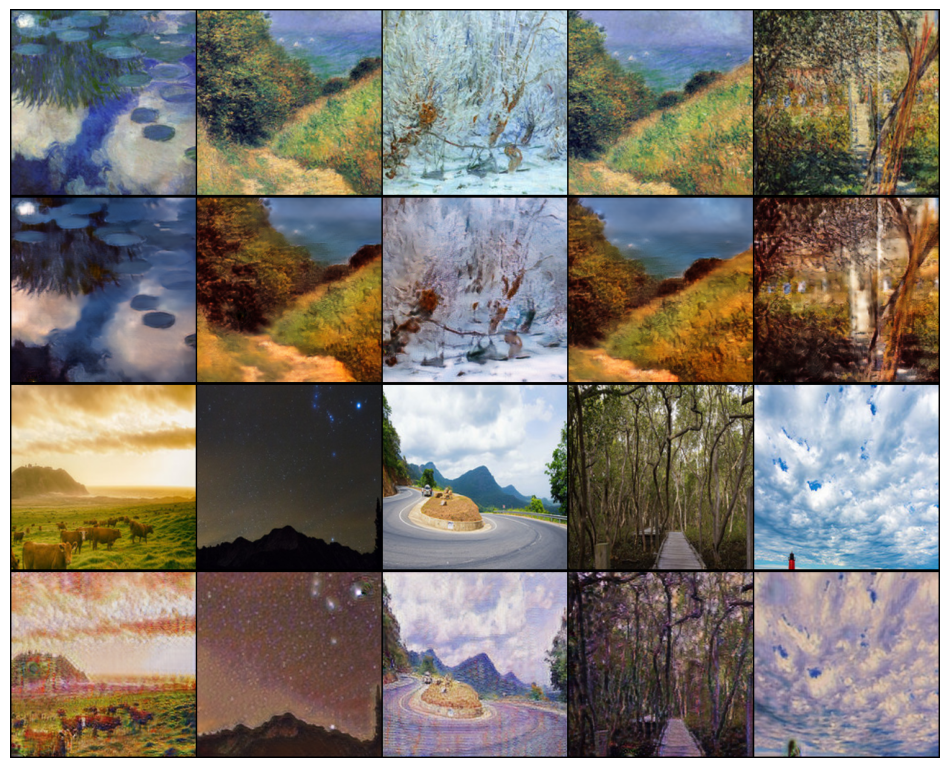

EPOCH: 14.000  loss_GAN: 0.660  loss_cycle: 0.144  loss_identity: 0.135  loss_D: 0.133  loss_G: 2.771  (13924.64s - 5967.70s remaining)
EPOCH: 15.000  loss_D: 0.066  loss_G: 2.706  loss_GAN: 1.131  loss_cycle: 0.105  loss_identity: 0.106  (14917.61s - 4972.54s remaining)

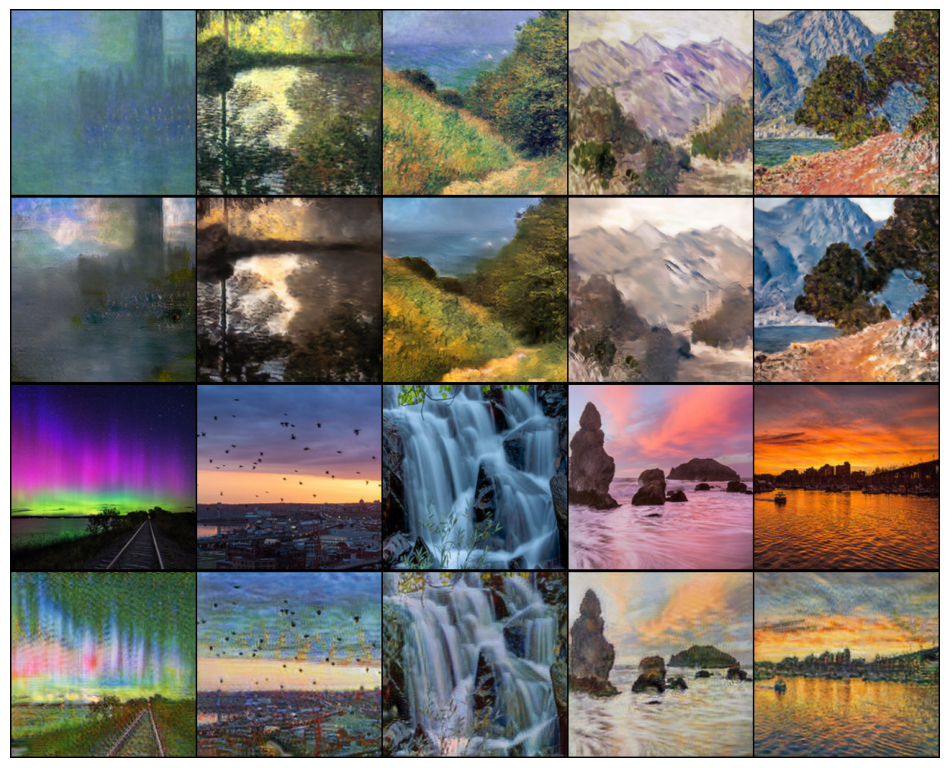

EPOCH: 15.000  loss_GAN: 0.704  loss_cycle: 0.142  loss_identity: 0.133  loss_D: 0.117  loss_G: 2.789  (14918.26s - 4972.75s remaining)
EPOCH: 16.000  loss_D: 0.180  loss_G: 2.112  loss_GAN: 0.847  loss_cycle: 0.084  loss_identity: 0.086  (15915.77s - 3978.94s remaining)

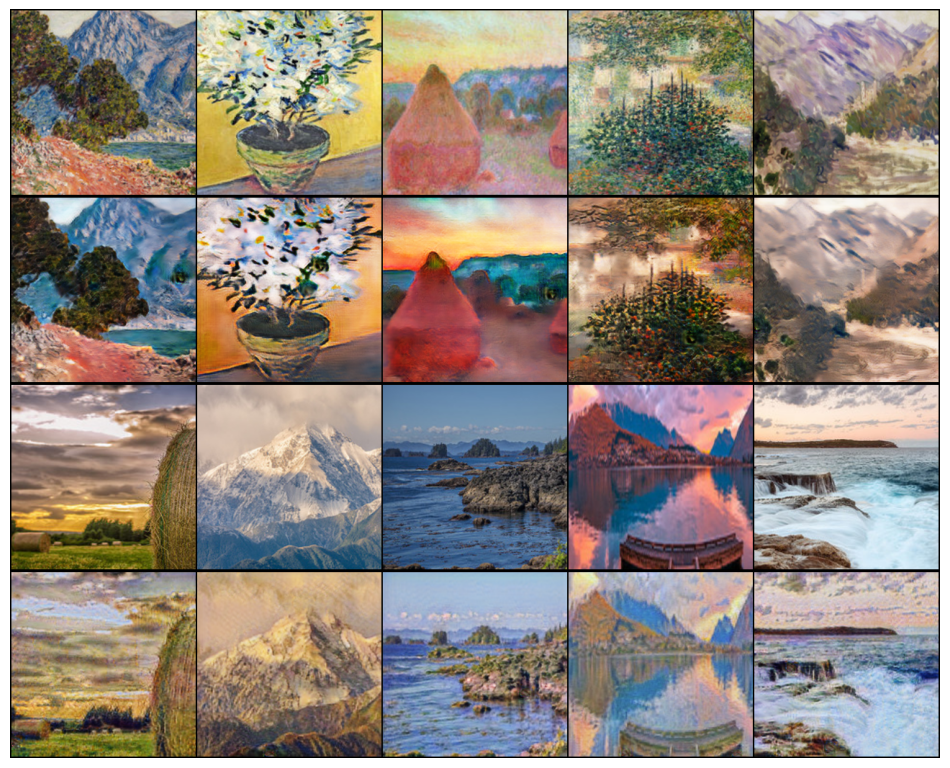

EPOCH: 16.000  loss_GAN: 0.745  loss_cycle: 0.138  loss_identity: 0.131  loss_D: 0.103  loss_G: 2.779  (15916.44s - 3979.11s remaining)
EPOCH: 17.000  loss_D: 0.082  loss_G: 2.535  loss_GAN: 0.773  loss_cycle: 0.116  loss_identity: 0.120  (16921.50s - 2986.15s remaining)

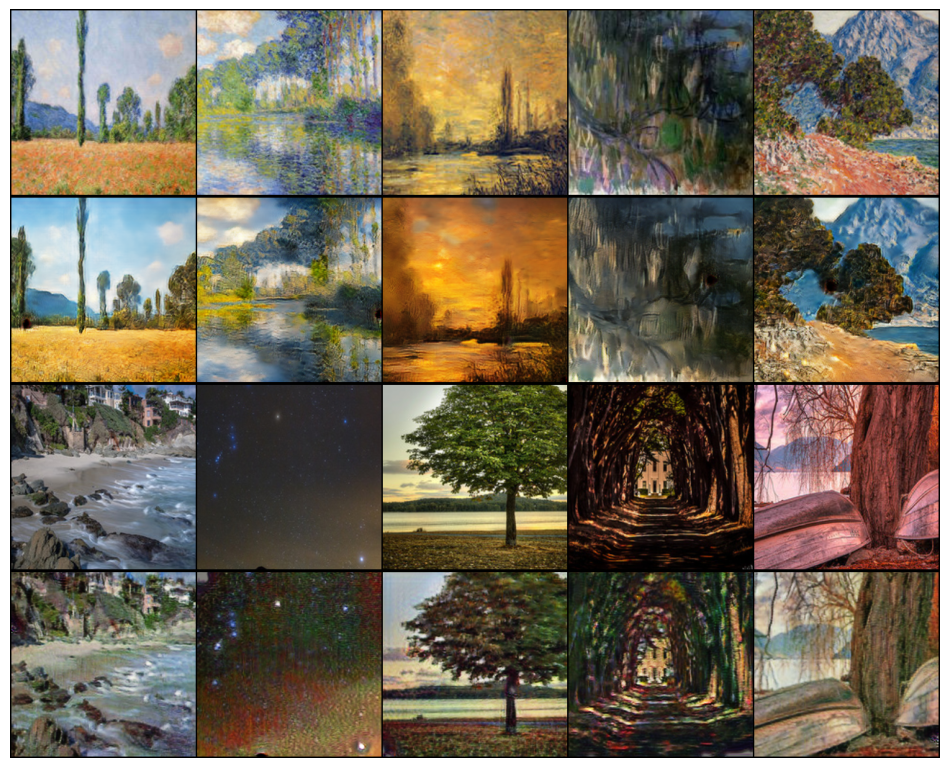

EPOCH: 17.000  loss_GAN: 0.776  loss_cycle: 0.136  loss_identity: 0.129  loss_D: 0.093  loss_G: 2.781  (16922.13s - 2986.26s remaining)
EPOCH: 18.000  loss_D: 0.086  loss_G: 2.407  loss_GAN: 0.714  loss_cycle: 0.122  loss_identity: 0.094  (17924.69s - 1991.63s remaining)

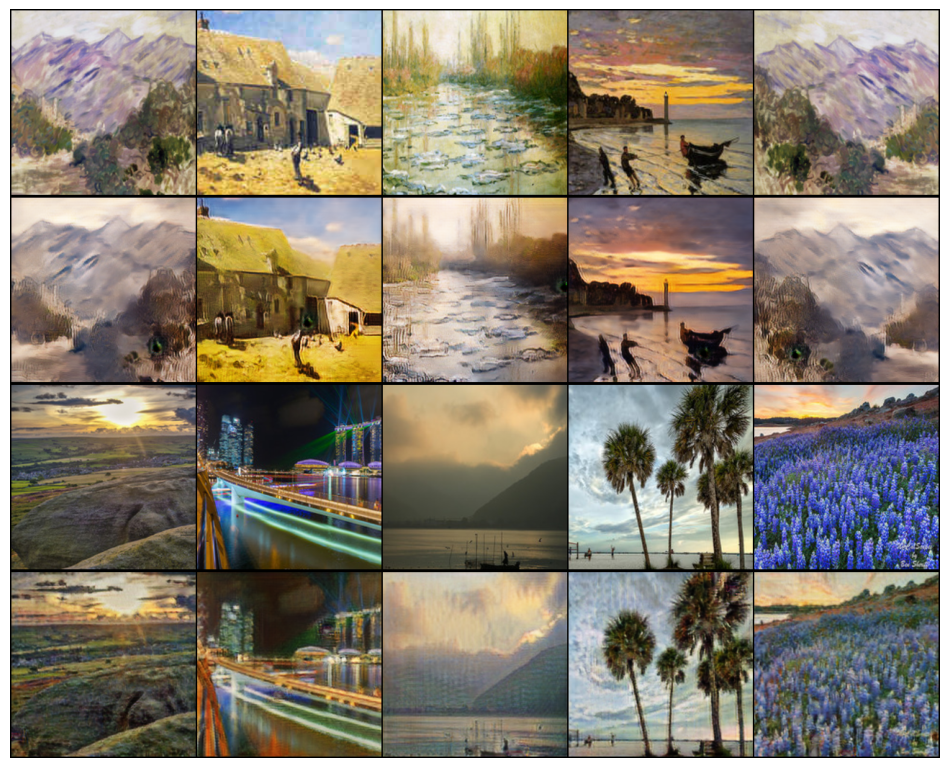

EPOCH: 18.000  loss_GAN: 0.795  loss_cycle: 0.134  loss_identity: 0.128  loss_D: 0.086  loss_G: 2.774  (17925.34s - 1991.70s remaining)
EPOCH: 19.000  loss_D: 0.125  loss_G: 2.490  loss_GAN: 0.766  loss_cycle: 0.125  loss_identity: 0.095  (18919.25s - 995.75s remaining))

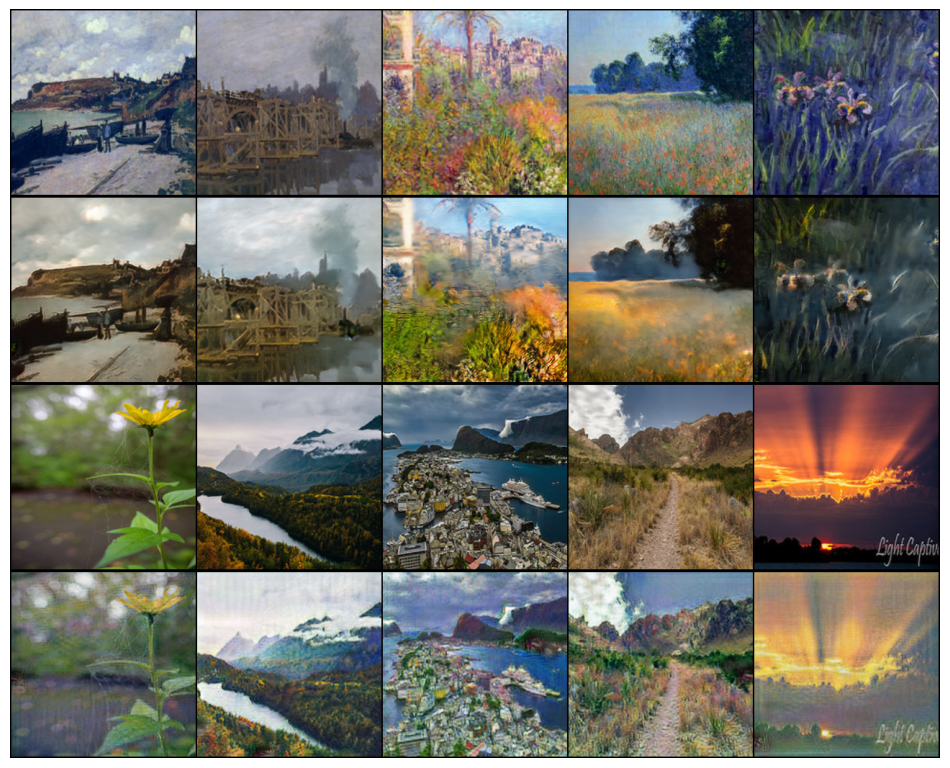

EPOCH: 19.000  loss_GAN: 0.792  loss_cycle: 0.130  loss_identity: 0.124  loss_D: 0.087  loss_G: 2.716  (18919.91s - 995.78s remaining)
EPOCH: 20.000  loss_D: 0.108  loss_G: 2.421  loss_GAN: 0.728  loss_cycle: 0.104  loss_identity: 0.131  (19918.80s - 0.00s remaining)))

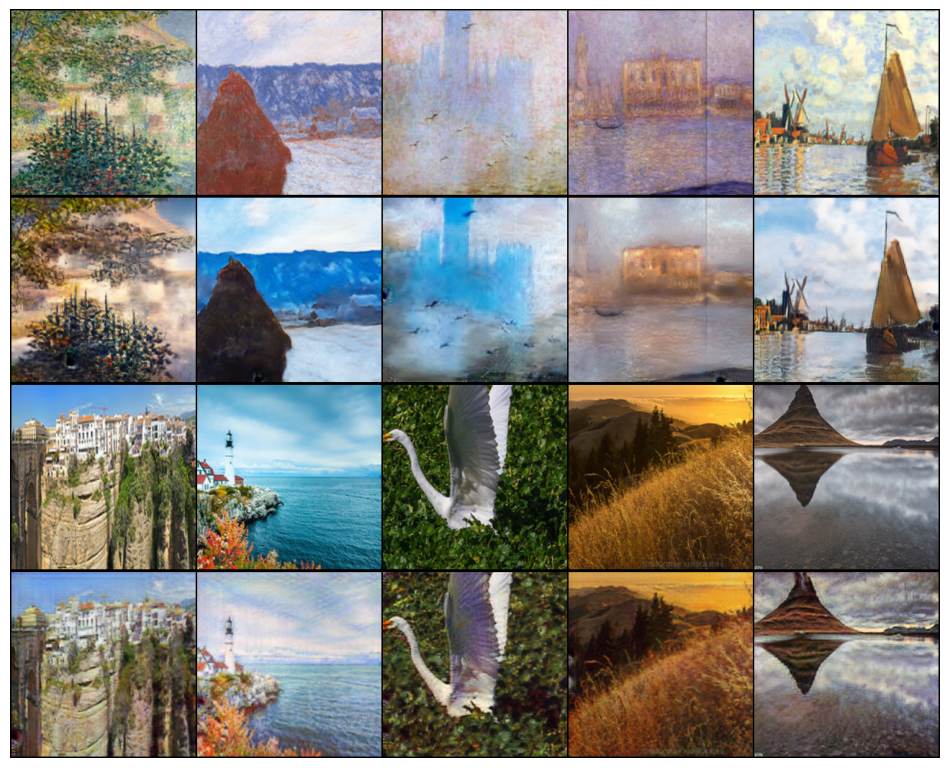

EPOCH: 20.000  loss_GAN: 0.798  loss_cycle: 0.130  loss_identity: 0.125  loss_D: 0.085  loss_G: 2.724  (19919.48s - 0.00s remaining)


In [ ]:
n_epochs = 20
log = Report(n_epochs)
for epoch in range(n_epochs):
    N = len(trn_dl)
    for bx, batch in enumerate(trn_dl):
        real_A, real_B = batch

        loss_G, loss_identity, loss_GAN, loss_cycle, loss_G, fake_A, fake_B = generator_train_step((G_AB,G_BA), optimizer_G, real_A, real_B)
        loss_D_A = discriminator_train_step(D_A, real_A, fake_A, optimizer_D_A)
        loss_D_B = discriminator_train_step(D_B, real_B, fake_B, optimizer_D_B)
        loss_D = (loss_D_A + loss_D_B) / 2

        log.record(epoch+(1+bx)/N, loss_D=loss_D.item(), loss_G=loss_G.item(),
                   loss_GAN=loss_GAN.item(), loss_cycle=loss_cycle.item(),
                   loss_identity=loss_identity.item(), end='\r')
    generate_sample()

    log.report_avgs(epoch+1)

In [ ]:
torch.save({
    'G_AB_state_dict': G_AB.state_dict(),
    'G_BA_state_dict': G_BA.state_dict(),
    'D_A_state_dict': D_A.state_dict(),
    'D_B_state_dict': D_B.state_dict(),
}, 'trained_models.pth')

In [ ]:
# Load the saved models
checkpoint = torch.load('trained_models.pth')
G_AB.load_state_dict(checkpoint['G_AB_state_dict'])
G_BA.load_state_dict(checkpoint['G_BA_state_dict'])
D_A.load_state_dict(checkpoint['D_A_state_dict'])
D_B.load_state_dict(checkpoint['D_B_state_dict'])

<All keys matched successfully>

In [ ]:
# Take an image
image = Image.open('R.jpg')

# Apply Cycle GAN on the image
transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

image = transform(image).unsqueeze(0).to(device)
fake_B = G_AB(image)
reconstructed_A = G_BA(fake_B)

# Convert the generated images back to numpy arrays
fake_B = fake_B.squeeze(0).detach().cpu().numpy()
reconstructed_A = reconstructed_A.squeeze(0).detach().cpu().numpy()

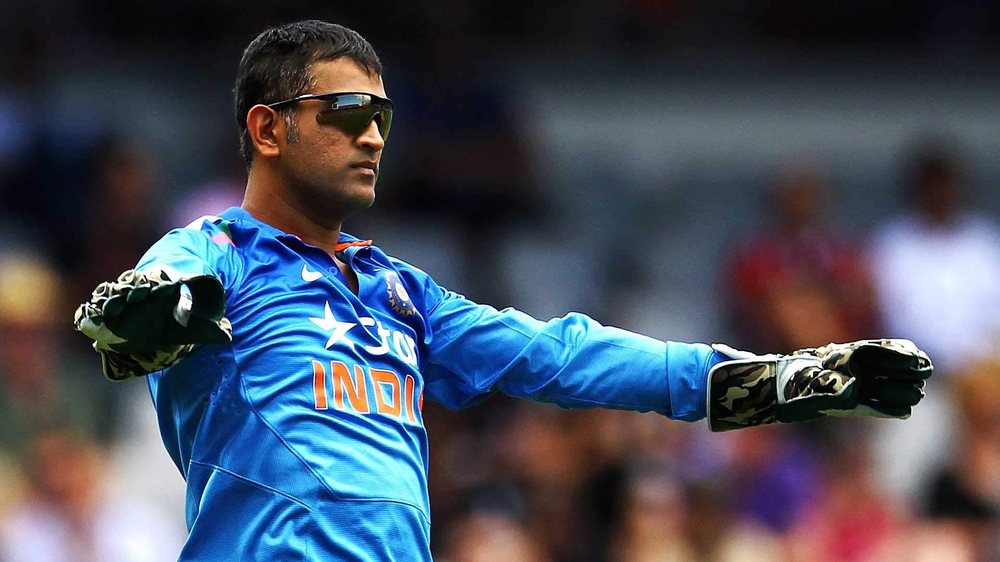

In [ ]:
from IPython.display import Image
Image(filename="R.jpg")

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


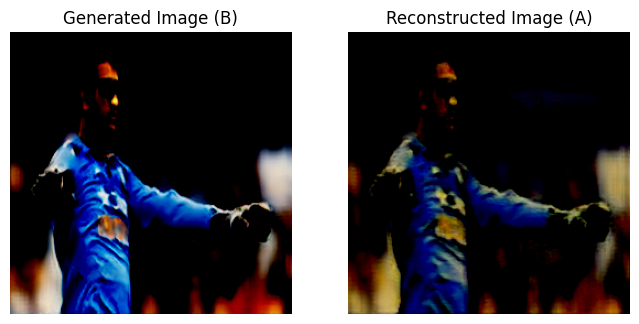

In [ ]:
# Display the generated images
plt.figure(figsize=(8, 8))
plt.subplot(1, 2, 1)
plt.imshow(np.transpose(fake_B, (1, 2, 0)))
plt.title('Generated Image (B)')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(np.transpose(reconstructed_A, (1, 2, 0)))
plt.title('Reconstructed Image (A)')
plt.axis('off')

plt.show()


100%|██████████| 121/121 [00:11<00:00, 10.77it/s]


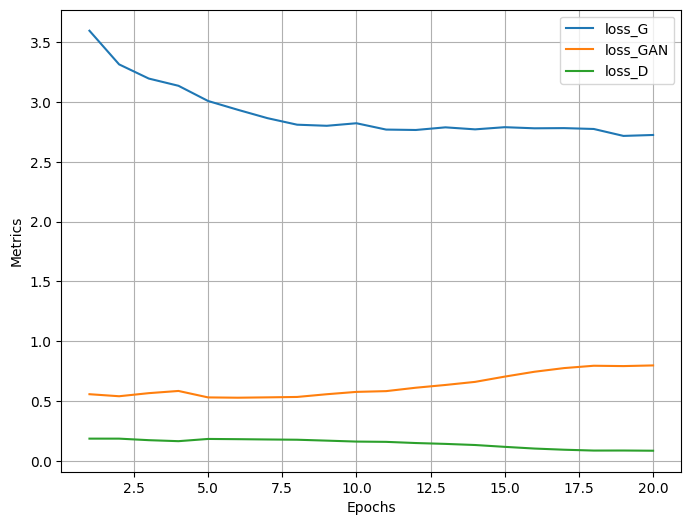

In [ ]:
log.plot_epochs(['loss_G','loss_GAN', 'loss_D'])

In all three cases, the loss starts high and trends downward as the number of epochs increases. The loss for the discriminator (loss_D) appears to be decreasing faster than the loss for the generator (loss_G) through most of the epochs. This could indicate that the discriminator is initially better at distinguishing between real and fake data than the generator is at creating realistic forgeries. However by around epoch 15 it appears the generator is starting to catch up to the discriminator.

# Observation

Training the model took a whopping 7 hours in the SJSU GPU lab! Even with high-end GPU computers, it still required a significant amount of time. This lengthy duration is quite common for training complex models like GANs, especially when dealing with large datasets and intricate architectures. Despite the long wait, it's essential to ensure the model's accuracy and performance, so every hour invested in training is worth it.